In [1]:
import json

import cv2
import matplotlib.pyplot as plt
from pathlib import Path

In [2]:
def plot_image(img, cmap=None, sz=(10, 10), axis=False):
    plt.figure(figsize=sz)
    plt.grid(True)
    if not axis:
        plt.axis('off')
        plt.grid(False)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img, cmap=cmap)
    plt.show()

In [3]:
def get_avg_bounding_poly_height(bounding_polys):
    """Calculate the average height of bounding polys in page

    Args:
        bounding_polys (list): list of boundingBoxs

    Returns:
        float: average height of bounding ploys
    """
    height_sum = 0
    for bounding_poly in bounding_polys:
        y1 = bounding_poly["boundingBox"]["vertices"][0].get('y', 0)
        y2 = bounding_poly["boundingBox"]["vertices"][2].get('y', 0)
        height_sum += y2 - y1
    avg_height = height_sum / len(bounding_polys)
    return avg_height

In [4]:
def find_centriod(bounding_poly):
    sum_of_x = 0
    sum_of_y = 0
    for vertice in bounding_poly["boundingBox"]["vertices"]:
        sum_of_x += vertice['x']
        sum_of_y += vertice['y']
    centriod = [sum_of_x/4, sum_of_y/4]
    return centriod

In [5]:
def get_height_range(avg_box_height, bounding_polys):
    height_diffs = []
    for bounding_poly in bounding_polys:
        y1 = bounding_poly["boundingBox"]["vertices"][0].get('y', 0)
        y2 = bounding_poly["boundingBox"]["vertices"][2].get('y', 0)
        height = y2-y1
        height_diffs.append(abs(avg_box_height-height))
    avg_diff = sum(height_diffs) // len(height_diffs)
    lower_bound_height = int(avg_box_height - avg_diff)
    upper_bound_height = int(avg_box_height+avg_diff)
    return lower_bound_height, upper_bound_height

In [6]:
def get_poly_sorted_on_y(bounding_poly_centriods):
    sorted_on_y_polys = sorted(bounding_poly_centriods , key=lambda k: [k[1]])
    return sorted_on_y_polys

def get_poly_sorted_on_x(sorted_on_y_polys, avg_box_height):
    prev_bounding_poly = sorted_on_y_polys[0]
    lines = []
    cur_line = []
    sorted_polys = []
    for bounding_poly in sorted_on_y_polys:
        if abs(bounding_poly[1]-prev_bounding_poly[1]) < avg_box_height/10:
            cur_line.append(bounding_poly)
        else:
            lines.append(cur_line)
            cur_line = []
            cur_line.append(bounding_poly)
        prev_bounding_poly = bounding_poly
    if cur_line:
        lines.append(cur_line)
    for line in lines:
        sorted_line = sorted(line, key=lambda k: [k[0]])
        sorted_polys.append(sorted_line)
    return sorted_polys

In [7]:
def sort_bounding_polys(main_region_bounding_polys):
    bounding_polys = {}
    bounding_poly_centriods = []
    avg_box_height = get_avg_bounding_poly_height(main_region_bounding_polys)
    for bounding_poly in main_region_bounding_polys:
        centroid = find_centriod(bounding_poly)
        bounding_polys[f"{centroid[0]},{centroid[1]}"] = bounding_poly
        bounding_poly_centriods.append(centroid)
    sorted_bounding_polys = []
    sort_on_y_polys = get_poly_sorted_on_y(bounding_poly_centriods)
    sorted_bounding_poly_centriods = get_poly_sorted_on_x(sort_on_y_polys, avg_box_height)
    for line_bounding_poly_centriod in sorted_bounding_poly_centriods:
        cur_line_polys = []
        for cur_line_box in line_bounding_poly_centriod:
            cur_line_polys.append(bounding_polys[f"{cur_line_box[0]},{cur_line_box[1]}"])
        sorted_bounding_polys.append(cur_line_polys)
    return sorted_bounding_polys

In [8]:
def get_first_column(lines):
    first_column_boxes = []
    for line in lines:
        first_column_boxes.append(line[0])
    return frist_column_boxes

In [9]:
def is_landscape_box(box):
    v = box['boundingBox']['vertices']
    width = int(v[0]['x']) - int(v[2]['x'])
    height = int(v[2]['y']) - int(v[0]['y'])
    if width > height:
        return True
    return False

In [10]:
def filter_bounding_polys_v1(lines_bounding_polys, lower_bound_height):
    main_region_bounding_polys = []
    noise_bounding_polys = []
    for line_boxes in lines_bounding_polys:
        for box_walker, line_box in enumerate(line_boxes,1):
            if box_walker < 3 and is_landscape_box(line_box):
                noise_bounding_polys.append(line_box)
            else:
                main_region_bounding_polys.append(line_box)
    return main_region_bounding_polys, noise_bounding_polys

In [11]:
def filter_bounding_polys_v2(lines_bounding_polys, lower_bound_height):
    main_region_bounding_polys = []
    noise_bounding_polys = []
    for line_boxes in lines_bounding_polys:
        for box_walker, line_box in enumerate(line_boxes,1):
            y1 = line_box["boundingBox"]["vertices"][0].get('y', 0)
            y2 = line_box["boundingBox"]["vertices"][2].get('y', 0)
            height = y2 - y1
            if box_walker < 3 and (is_landscape_box(line_box) or height<lower_bound_height):
                noise_bounding_polys.append(line_box)
            else:
                main_region_bounding_polys.append(line_box)
    return main_region_bounding_polys, noise_bounding_polys

In [12]:
def filter_bounding_polys_v3(lines_bounding_polys, lower_bound_height):
    main_region_bounding_polys = []
    noise_bounding_polys = []
    for bounding_poly in lines_bounding_polys:
        y1 = bounding_poly["boundingBox"]["vertices"][0].get('y', 0)
        y2 = bounding_poly["boundingBox"]["vertices"][2].get('y', 0)
        height = y2 - y1
        if is_landscape_box(bounding_poly) or height < lower_bound_height:
            noise_bounding_polys.append(bounding_poly)
        else:
            main_region_bounding_polys.append(bounding_poly)
    return main_region_bounding_polys, noise_bounding_polys

In [13]:
def filter_bounding_polys_v5(lines_bounding_polys, lower_bound_height):
    main_region_bounding_polys = []
    noise_bounding_polys = []
    for bounding_poly in lines_bounding_polys:
        y1 = bounding_poly["boundingBox"]["vertices"][0].get('y', 0)
        y2 = bounding_poly["boundingBox"]["vertices"][2].get('y', 0)
        height = y2 - y1
        if height<lower_bound_height:
            noise_bounding_polys.append(bounding_poly)
        else:
            main_region_bounding_polys.append(bounding_poly)
    return main_region_bounding_polys, noise_bounding_polys

In [14]:
def filter_bounding_polys_v4(lines_bounding_polys, lower_bound_height):
    main_region_bounding_polys = []
    noise_bounding_polys = []
    for bounding_poly in lines_bounding_polys:
        if is_landscape_box(bounding_poly):
            noise_bounding_polys.append(bounding_poly)
        else:
            main_region_bounding_polys.append(bounding_poly)
    return main_region_bounding_polys, noise_bounding_polys

In [15]:
def get_symbol(response):
    for page in response['fullTextAnnotation']['pages']:
        for block in page['blocks']:
            for paragraph in block['paragraphs']:
                for word in paragraph['words']:
                    for symbol in word['symbols']:
                        char = symbol['text']
                        v = symbol['boundingBox']['vertices']
                        box = [v[0]['x'], v[0]['y'], v[2]['x'], v[2]['y']]
                        yield char, symbol

In [16]:
def get_full_text_annotations_v1(response):
    boxes, text = [], ''
    for char, box in get_symbol(response):
        text += char
        boxes.append(box)
    avg_box_height = get_avg_bounding_poly_height(boxes)
    lower_bound_height, upper_bound_height = get_height_range(avg_box_height, boxes)
    boxes = sort_bounding_polys(boxes)
    m_boxes, n_boxes = filter_bounding_polys_v1(boxes, lower_bound_height)
    return m_boxes, n_boxes

In [17]:
def get_full_text_annotations_v2(response):
    boxes, text = [], ''
    for char, box in get_symbol(response):
        text += char
        boxes.append(box)
    avg_box_height = get_avg_bounding_poly_height(boxes)
    lower_bound_height, upper_bound_height = get_height_range(avg_box_height, boxes)
    boxes = sort_bounding_polys(boxes)
    m_boxes, n_boxes = filter_bounding_polys_v2(boxes, lower_bound_height)
    return m_boxes, n_boxes

In [18]:
def get_full_text_annotations_v3(response):
    boxes, text = [], ''
    for char, box in get_symbol(response):
        text += char
        boxes.append(box)
    avg_box_height = get_avg_bounding_poly_height(boxes)
    lower_bound_height, upper_bound_height = get_height_range(avg_box_height, boxes)
    m_boxes, n_boxes = filter_bounding_polys_v3(boxes, lower_bound_height)
    return m_boxes, n_boxes

In [19]:
def get_full_text_annotations_v4(response):
    boxes, text = [], ''
    for char, box in get_symbol(response):
        text += char
        boxes.append(box)
    avg_box_height = get_avg_bounding_poly_height(boxes)
    lower_bound_height, upper_bound_height = get_height_range(avg_box_height, boxes)
    m_boxes, n_boxes = filter_bounding_polys_v4(boxes, lower_bound_height)
    return m_boxes, n_boxes

In [20]:
def get_full_text_annotations_v5(response):
    boxes, text = [], ''
    for char, box in get_symbol(response):
        text += char
        boxes.append(box)
    avg_box_height = get_avg_bounding_poly_height(boxes)
    lower_bound_height, upper_bound_height = get_height_range(avg_box_height, boxes)
    m_boxes, n_boxes = filter_bounding_polys_v5(boxes, lower_bound_height)
    return m_boxes, n_boxes

In [57]:
def plot_boxes(img, boxes, color=[0,0,255]):
    for x1, y1, x2, y2 in boxes:
        cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)

    plot_image(img, sz=(25, 25))

In [22]:
def get_boxes(polys):
    boxes = []
    for poly in polys:
        v = poly['boundingBox']['vertices']
        boxes.append([v[0]['x'], v[0]['y'], v[2]['x'], v[2]['y']])
    return boxes

In [62]:
def plot_line(image_file_path, ocr_output_file_path):
    boxes = []
    line_boxes = {}
    
    image = cv2.imread(str(image_file_path))
    ocr_output = json.load(open(ocr_output_file_path))
    
    for char, box in get_symbol(ocr_output):
        boxes.append(box)
    lines_polys = sort_bounding_polys(boxes)
    
    for line_num, line_polys in enumerate(lines_polys, 1):
        first_box = line_polys[0]
        top_left_corner = [first_box['boundingBox']['vertices'][0]['x'], first_box['boundingBox']['vertices'][0]['y']]
        last_box = line_polys[-1]
        bottom_right_corner = [last_box['boundingBox']['vertices'][2]['x'], last_box['boundingBox']['vertices'][2]['y']]
        line_box = [top_left_corner[0], top_left_corner[1], bottom_right_corner[0], bottom_right_corner[1]]
        line_boxes[line_num] = line_box
    color=[0,0,255]
    for line_num, (x1, y1, x2, y2) in line_boxes.items():
        cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
        cv2.putText(image, str(line_num), (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36,255,12), 2)

    plot_image(image, sz=(25, 25))

In [38]:
def plot_v1(image_file_path, ocr_output_file_path):
    
    image = cv2.imread(str(image_file_path))
    ocr_output = json.load(open(ocr_output_file_path))

    m_boxes, n_boxes = get_full_text_annotations_v1(ocr_output)
    m_boxes = get_boxes(m_boxes)
    n_boxes = get_boxes(n_boxes)
#     plot_boxes(image, m_boxes)
    plot_boxes(image, n_boxes)

In [39]:
def plot_v2(image_file_path, ocr_output_file_path):
    
    image = cv2.imread(str(image_file_path))
    ocr_output = json.load(open(ocr_output_file_path))

    m_boxes, n_boxes = get_full_text_annotations_v2(ocr_output)
    m_boxes = get_boxes(m_boxes)
    n_boxes = get_boxes(n_boxes)
#     plot_boxes(image, m_boxes)
    plot_boxes(image, n_boxes)

In [33]:
def plot_v3(image_file_path, ocr_output_file_path):
    
    image = cv2.imread(str(image_file_path))
    ocr_output = json.load(open(ocr_output_file_path))

    m_boxes, n_boxes = get_full_text_annotations_v3(ocr_output)
    m_boxes = get_boxes(m_boxes)
    n_boxes = get_boxes(n_boxes)
#     plot_boxes(image, m_boxes)
    plot_boxes(image, n_boxes)

In [34]:
def plot_v4(image_file_path, ocr_output_file_path):
    
    image = cv2.imread(str(image_file_path))
    ocr_output = json.load(open(ocr_output_file_path))

    m_boxes, n_boxes = get_full_text_annotations_v4(ocr_output)
    m_boxes = get_boxes(m_boxes)
    n_boxes = get_boxes(n_boxes)
#     plot_boxes(image, m_boxes)
    plot_boxes(image, n_boxes)

In [35]:
def plot_v5(image_file_path, ocr_output_file_path):
    
    image = cv2.imread(str(image_file_path))
    ocr_output = json.load(open(ocr_output_file_path))

    m_boxes, n_boxes = get_full_text_annotations_v5(ocr_output)
    m_boxes = get_boxes(m_boxes)
    n_boxes = get_boxes(n_boxes)
#     plot_boxes(image, m_boxes)
    plot_boxes(image, n_boxes)

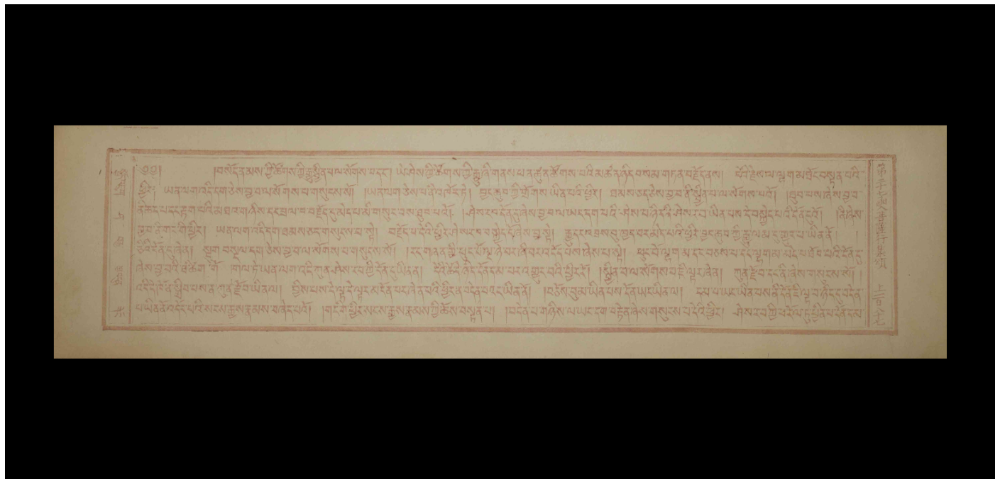

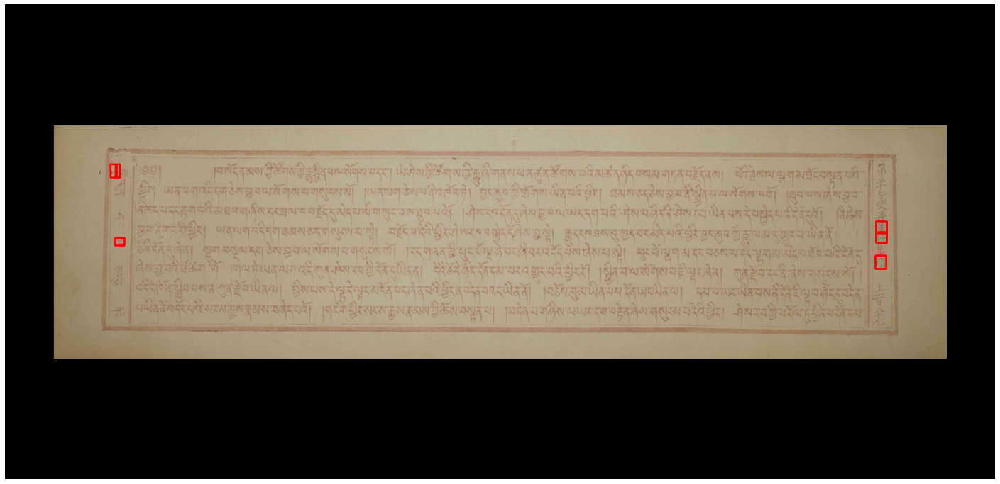

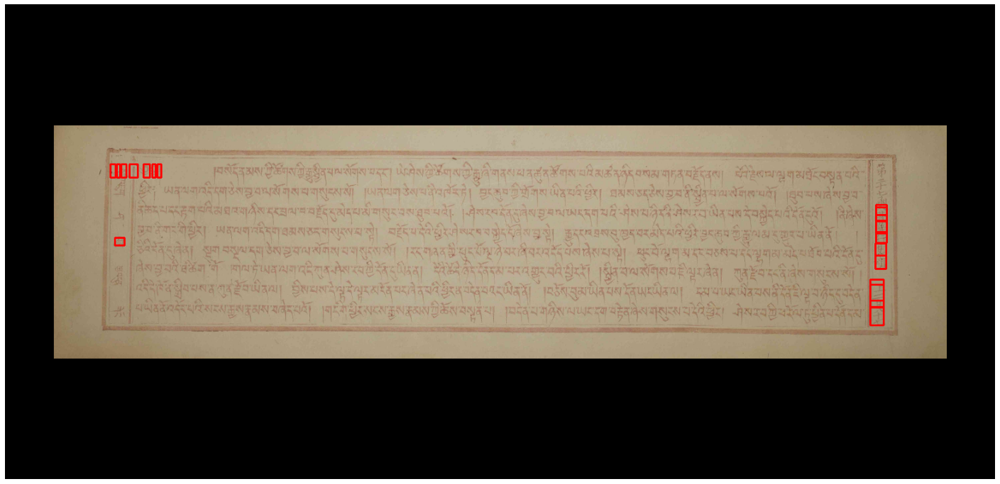

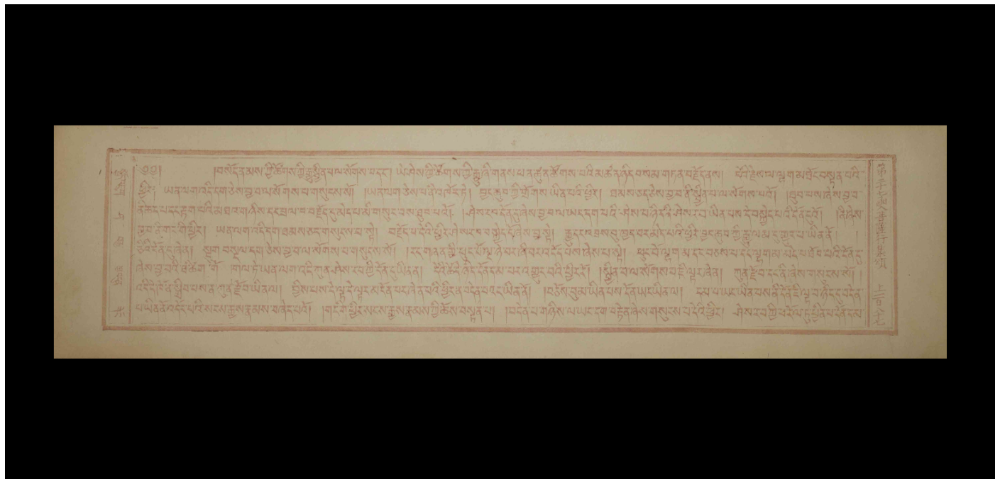

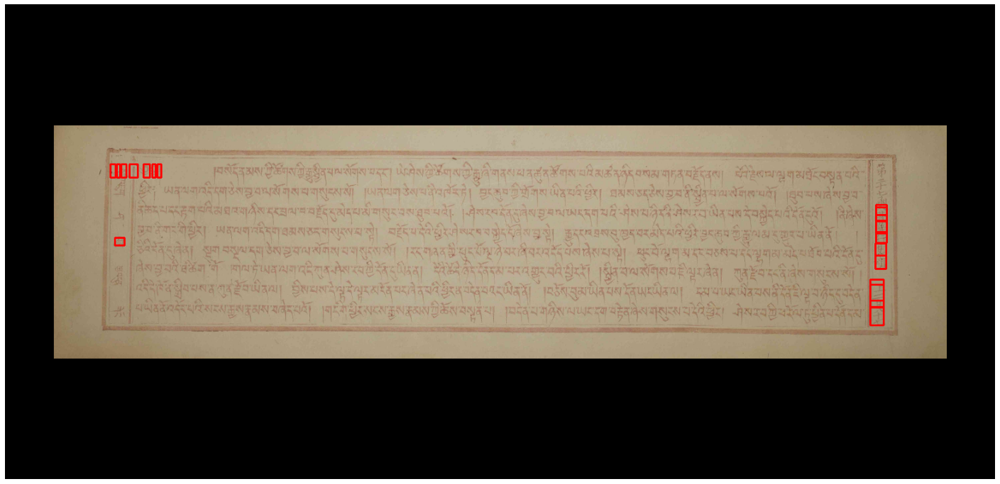

...

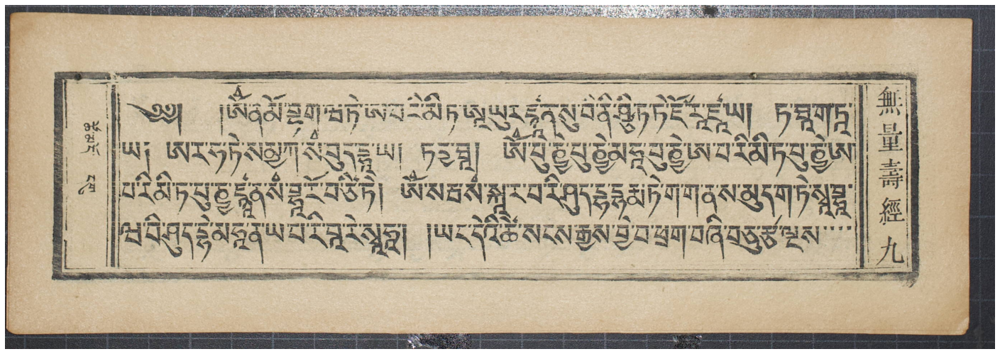

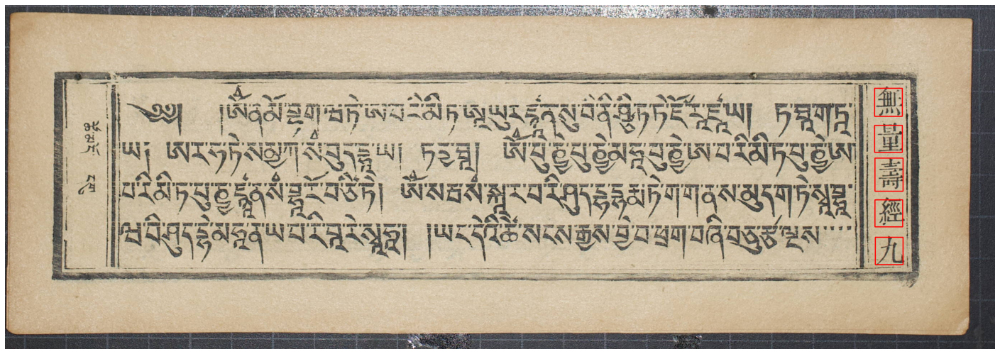

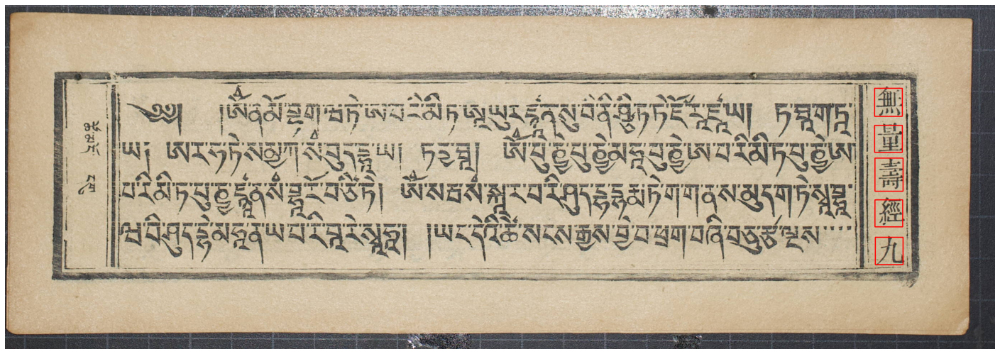

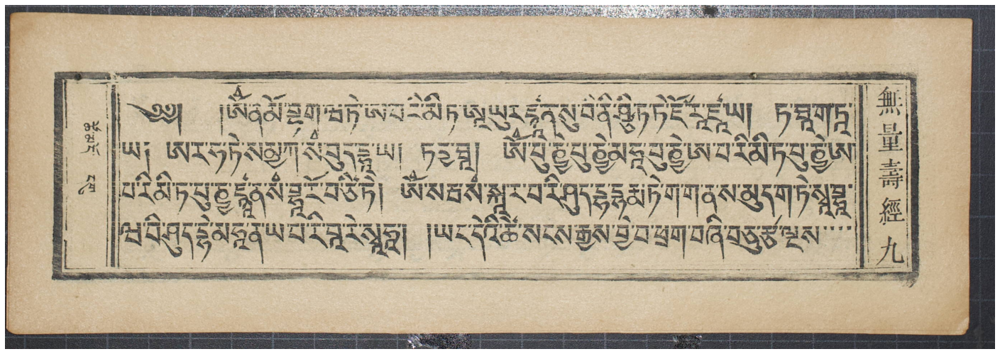

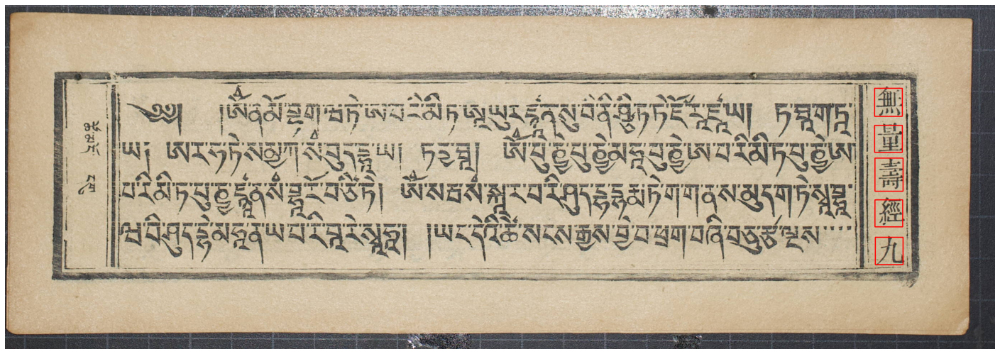

In [64]:
image_paths = list(Path('./data/image/test/').iterdir())
image_paths.sort()
ocr_output_paths = list(Path('./data/test_re/').iterdir())
ocr_output_paths.sort()
for image_path, ocr_output_path in zip(image_paths, ocr_output_paths):
    plot_v1(image_path, ocr_output_path)
    plot_v2(image_path, ocr_output_path)
    plot_v3(image_path, ocr_output_path)
    plot_v4(image_path, ocr_output_path)
    plot_v5(image_path, ocr_output_path)

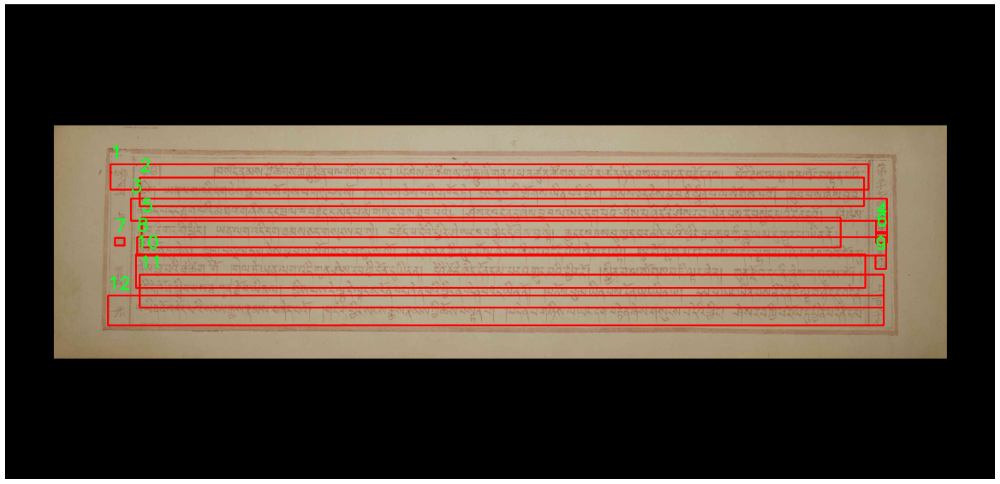

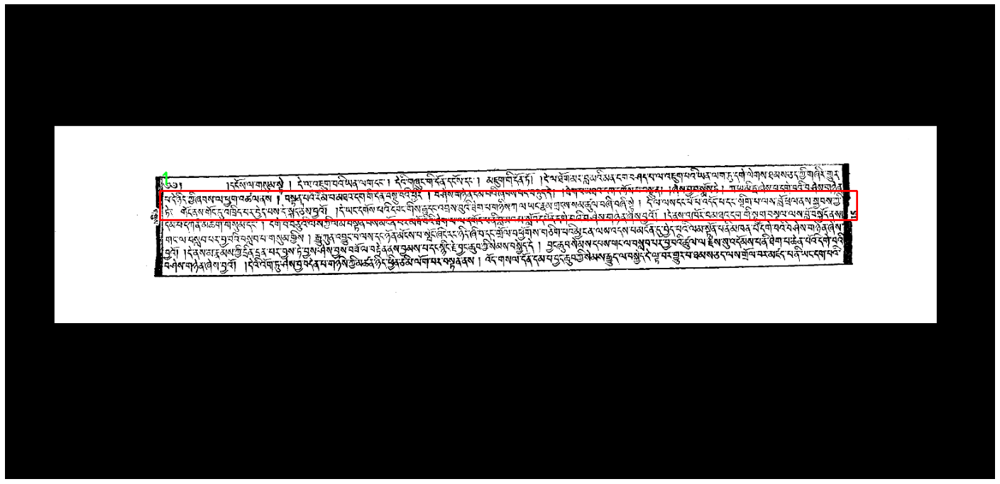

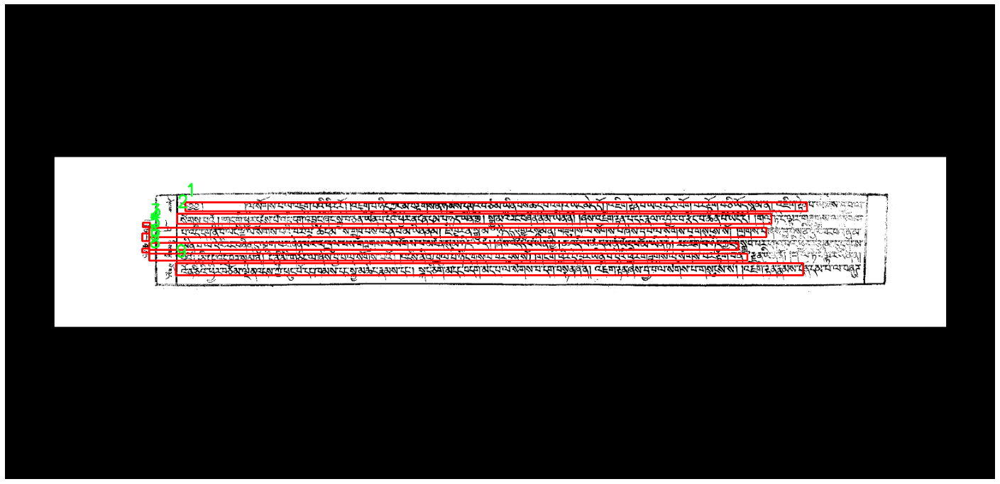

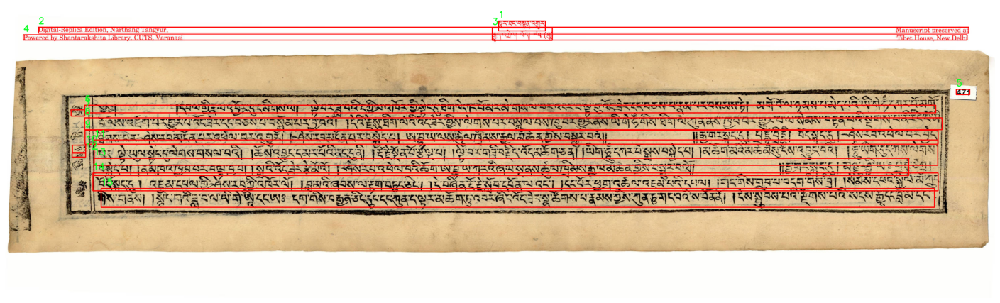

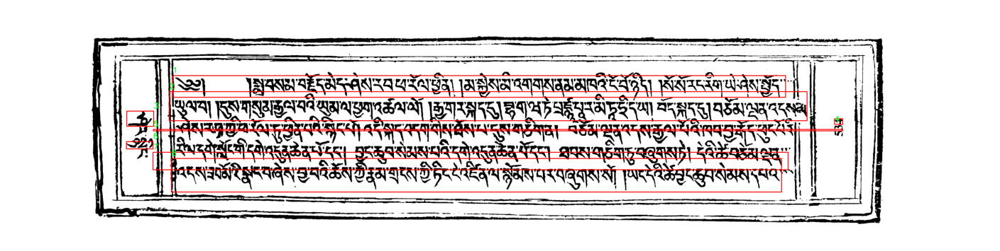

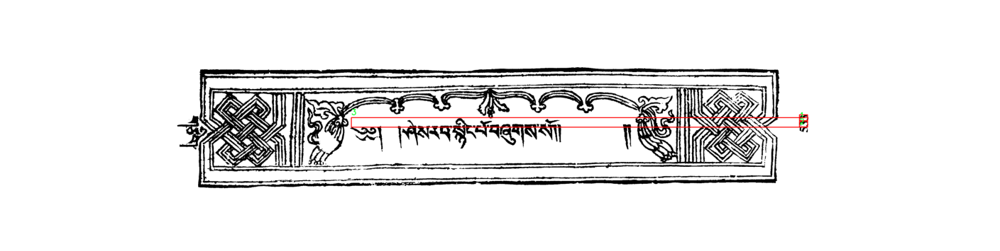

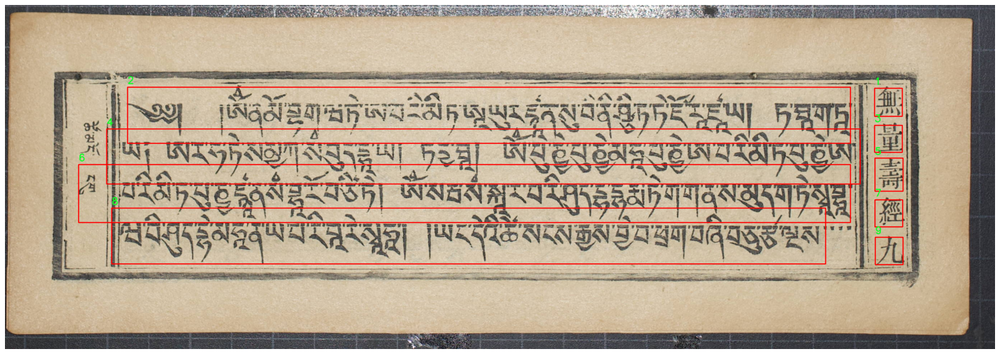

In [63]:
image_paths = list(Path('./data/image/test/').iterdir())
image_paths.sort()
ocr_output_paths = list(Path('./data/test_re/').iterdir())
ocr_output_paths.sort()
for image_path, ocr_output_path in zip(image_paths, ocr_output_paths):
    plot_line(image_path, ocr_output_path)